# Internship ICESat-2 ATL03

## Data Acquisition and Import

In [1]:
# import modules

# basics
import os, glob, sys
import warnings
from timeit import default_timer as timer
import matplotlib.pyplot as plt
import pandas as pd
pd.options.mode.chained_assignment = None
import numpy as np
import geopandas as gp
import rasterio
import h5py

# projection
from pyproj import Transformer
from pyproj import proj

# PC neighborhoods
from pykdtree.kdtree import KDTree as pyKDTree
from numba import njit, prange

# fitting
from scipy.ndimage import gaussian_filter
from pykalman import KalmanFilter
import statsmodels.api as sm
lowess = sm.nonparametric.lowess

# import own functions 
sys.path.append('my_functions')
from from_SVDA_functions import *
from polyfit_functions import *
from eigenvalues_numba import *

In [2]:
# Data extraction from ATL03 product (HDF5 formatted files)

# input: h5 file of ATL03 track data from NSIDC Data Access Tool
ATL03_input_path = '../data/ICESAT_Tracks/raw_h5/ATL03_20220529163730_10321508_005_02.h5'

# output: folder for processed h5 swath files
ATL03_output_path = '../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/'

# region of interest (bounding box of ROI = clip mask of tracks)
ROI_fname = '../data/supporting_data/toro_shp.shp'
EPSG_Toro = 'epsg:32720'

# create subsetted hdf5 files of each swath with SVDA extraction function (modified from Atmani, Bodo Bookhagen, and Smith, 2022)
ATL03_files = list(glob.glob(ATL03_input_path))
ATL03_files.sort()
for fname in ATL03_files:  
    ATL03_signal_photons(fname, ATL03_output_path, ROI_fname, EPSG_Toro, reprocess=False)

# load in extracted hdf files of all 6 ground tracks
ATL03_land_files = glob.glob(os.path.join(ATL03_output_path, 'ATL03_Land_*.hdf'))
ATL03_land_files.sort()

# set up a dataframe list and fill with dataframes of each individual ground track (6 total)
ATL03_list = []
for i in range(len(ATL03_land_files)):
    ATL03_df = pd.read_hdf(ATL03_land_files[i], mode='r')
    ATL03_df = ATL03_df.sort_values(by=['alongtrack'], ascending=True).reset_index()
    ATL03_list.append(ATL03_df)

# define names of beams   
tracknames = ['GT1L', 'GT1R', 'GT2L', 'GT2R', 'GT3L', 'GT3R']

Opening ATL03_20220529163730_10321508_005_02.h5: gt1l
File ../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/ATL03_Land_20220529163730_gt1l.hdf already exists and reprocessing is turned off.

Opening ATL03_20220529163730_10321508_005_02.h5: gt1r
File ../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/ATL03_Land_20220529163730_gt1r.hdf already exists and reprocessing is turned off.

Opening ATL03_20220529163730_10321508_005_02.h5: gt2l
File ../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/ATL03_Land_20220529163730_gt2l.hdf already exists and reprocessing is turned off.

Opening ATL03_20220529163730_10321508_005_02.h5: gt2r
File ../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/ATL03_Land_20220529163730_gt2r.hdf already exists and reprocessing is turned off.

Opening ATL03_20220529163730_10321508_005_02.h5: gt3l
File ../data/ICESAT_Tracks/hdf/ATL03_20220529163730_10321508_005_02/ATL03_Land_20220529163730_gt3l.hdf already exists and repr

In [4]:
fig, ax = plt.subplots(1,1, figsize=(15,8))
fig.set_dpi(900)
ax.scatter(ATL03_list[0]['alongtrack_base'][ATL03_list[0]['Land'] == 0],  ATL03_list[0]['Photon_Height'][ATL03_list[0]['Land'] == 0],  s=0.5, label='noise', c='gray')
ax.scatter(ATL03_list[0]['alongtrack_base'][ATL03_list[0]['Land'] == -1], ATL03_list[0]['Photon_Height'][ATL03_list[0]['Land'] == -1], s=0.5, label='unspecific', c='tab:blue')
ax.scatter(ATL03_list[0]['alongtrack_base'][ATL03_list[0]['Land'] == 2],  ATL03_list[0]['Photon_Height'][ATL03_list[0]['Land'] == 2],  s=0.5, label='low confidence', c='tab:red')
ax.scatter(ATL03_list[0]['alongtrack_base'][ATL03_list[0]['Land'] == 3],  ATL03_list[0]['Photon_Height'][ATL03_list[0]['Land'] == 3],  s=0.5, label='medium confidence', c='tab:orange')
ax.scatter(ATL03_list[0]['alongtrack_base'][ATL03_list[0]['Land'] == 4],  ATL03_list[0]['Photon_Height'][ATL03_list[0]['Land'] == 4],  s=0.5, label='high confidence', c='tab:green')
ax.set_title(tracknames[0], fontsize=14)
ax.set_ylabel('Photon height [m]', fontsize=12)
ax.set_xlabel('Distance along track [m]', fontsize=12)
ax.legend(loc=(1.0, 0), frameon=False, fontsize=9);
plt.savefig('../figures/photon_dist.png', bbox_inches='tight')

<p style="text-align:center"> Fig. 2: ICESat-2 swath photons of beam GT1L, plotted along the swath distance against the photon height </p>

In [5]:
# DEMs and geoid dataset
# all rasters are in WGS84 projection (ESPG:4326)
# nodata values are set to NaN

# SPOT 3m DEM
src_qdt3 = rasterio.open('../data/supporting_data/DEMs/QdT_DEM_3m_4326.tif')
array_qdt3 = src_qdt3.read(1)
array_qdt3[array_qdt3==src_qdt3.nodata] = np.nan

# Copernicus GLO-30 DEM
src_glo30 = rasterio.open('../data/supporting_data/DEMs/output_COP30_1.tif')
array_glo30 = src_glo30.read(1)
array_glo30[array_glo30==src_glo30.nodata] = np.nan

# Salta Sector 51 5 m DEM
src_salta5 = rasterio.open('../data/supporting_data/DEMs/salta_sect51_toro_5m_wgs84_utm19s_4326.tif')
array_salta5 = src_salta5.read(1)
array_salta5[array_salta5==src_salta5.nodata] = np.nan

# Geoid (to correct differences in vertical datum)
src_geoid = rasterio.open('../data/supporting_data/DEMs/us_nga_egm2008_1_4326.tif')
array_geoid = src_geoid.read(1)
array_geoid[array_geoid==src_geoid.nodata] = np.nan

## Methods for Ground Profile Retrieval

In [6]:
# set up a x-z (distance along track, elevation) array to test suitability of methods on 

# create new df that includes all photons of ATL03 df swath 1 that have a confidence level of 2 or higher (low confidence or better)
ATL_conf = ATL03_list[0][ATL03_list[0]['Land'] >= 2]

# create numpy array from ATL_conf that includes only distance along track and photon height
xy = ATL_conf[['alongtrack_base', 'Photon_Height']].to_numpy()

### Initial objective: eigenvalues

In [5]:
# outlier filter xy and then calculate eigenvalues and their standard deviations 
# for the neighborhood sizes [10, 50, 100, 150, 250, 400]
xy_fil, _ = outlier_filter_k(xy, 50, 20)
eva_sw1, std_sw1 = evalues_pyKDTree_kN_loop(xy = xy_fil)

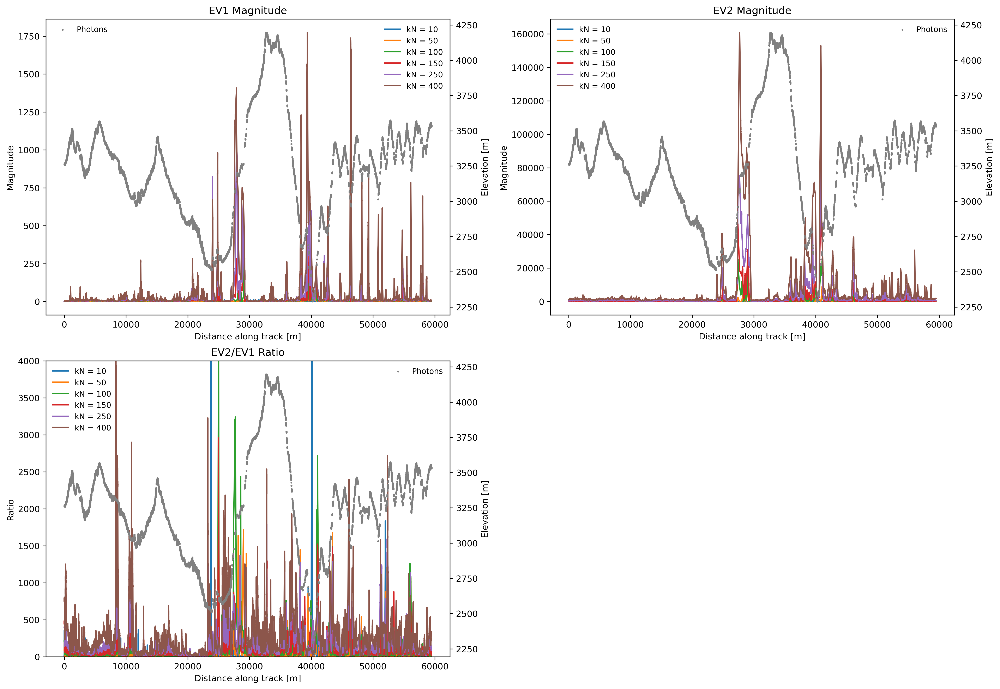

In [6]:
# plot eigenvalues and their ratio
 
kN_arr = np.array([10, 50, 100, 150, 250, 400])
fig, axes = plt.subplots(2,2,figsize=(16,11), constrained_layout = True)
fig.set_dpi(300)
ax1, ax2, ax3, ax4 = axes.flatten()

for i in np.arange(0,len(eva_sw1)):
    ax1.plot(xy_fil[:,0], eva_sw1[i][:,0], label=f'kN = {kN_arr[i]}')
axt = ax1.twinx()
axt.scatter(xy_fil[:,0], xy_fil[:,1], s=1, c='grey', label='Photons')
axt.set_ylabel('Elevation [m]')
axt.legend(bbox_to_anchor=(0.17, 1), frameon=False, fontsize=9)
ax1.legend(frameon=False, fontsize=9)
ax1.set_xlabel('Distance along track [m]')
ax1.set_ylabel('Magnitude')
ax1.set_title('EV1 Magnitude')

for i in np.arange(0,len(eva_sw1)):
    ax2.plot(xy_fil[:,0], eva_sw1[i][:,1], label=f'kN = {kN_arr[i]}')
axt = ax2.twinx()
axt.scatter(xy_fil[:,0], xy_fil[:,1], s=1, c='grey', label='Photons')
axt.set_ylabel('Elevation [m]')
axt.legend(bbox_to_anchor=(1, 1), frameon=False, fontsize=9)
ax2.legend(loc='upper left', frameon=False, fontsize=9)
axt.set_ylabel('Elevation [m]')
ax2.set_xlabel('Distance along track [m]')
ax2.set_ylabel('Magnitude')
ax2.set_title('EV2 Magnitude')

for i in np.arange(0,len(eva_sw1)):
    ax3.plot(xy_fil[:,0], eva_sw1[i][:,1]/eva_sw1[i][:,0], label=f'kN = {kN_arr[i]}')
axt = ax3.twinx()
axt.scatter(xy_fil[:,0], xy_fil[:,1], s=1, c='grey', label='Photons')
axt.set_ylabel('Elevation [m]')
axt.legend(bbox_to_anchor=(1, 1), frameon=False, fontsize=9)
ax3.legend(loc='upper left', frameon=False, fontsize=9)
ax3.set_ylim(0,4000)
ax3.set_xlabel('Distance along track [m]')
ax3.set_ylabel('Ratio')
ax3.set_title('EV2/EV1 Ratio');

ax4.axis('off');

<p style="text-align:center"> Fig. 3: Magnitude and ratio of eigenvalues 1 and 2 </p>

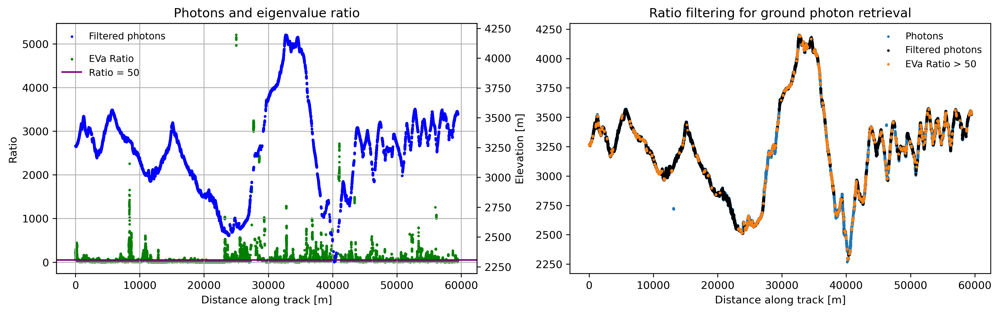

In [8]:
# plot ratio, chosen threshold and photons that pass the threshold as ground photons

fig, axes = plt.subplots(1,2, figsize=(13,4), constrained_layout = True)
ax1, ax2 = axes
fig.set_dpi(300)

axt = ax1.twinx()
axt.scatter(xy_fil[:,0], xy_fil[:,1], s=2, c='b', label='Filtered photons')

ratio = eva_sw1[2][:,1]/eva_sw1[2][:,0]
ax1.scatter(xy_fil[:,0], ratio, label='EVa Ratio', s=2, c='g')
ax1.axhline(50, c='purple', label='Ratio = 50');
ax1.grid()
ax1.set_title('Photons and eigenvalue ratio')
ax1.set_ylabel('Ratio')
axt.set_ylabel('Elevation [m]')
ax1.set_xlabel('Distance along track [m]')
axt.legend(bbox_to_anchor=(0.28, 1), frameon=False, fontsize=9)
ax1.legend(bbox_to_anchor=(0.218, 0.91), frameon=False, fontsize=9)

idx_linearity, = np.where(ratio > 50)
xy2 = xy_fil[idx_linearity]

ax2.scatter(xy[:,0], xy[:,1], s=2, label='Photons')
ax2.scatter(xy_fil[:,0], xy_fil[:,1], s=2, label='Filtered photons', c='k')
ax2.scatter(xy2[:,0],xy2[:,1], label='EVa Ratio > 50', s=2)
ax2.legend(frameon=False, fontsize=9)
ax2.set_xlabel('Distance along track [m]')
ax2.set_title('Ratio filtering for ground photon retrieval');

<p style="text-align:center"> Fig. 4: Using eigenvalue ratio (neighborhood size: 100) for ground photon retrieval </p>

### Polynomial fitting

#### find best parameters

In [7]:
# define swath subset by start point and length (both in meters)
s = 0
l = 20000

# create new array that is subsetted by defined segment
xy = xy[(xy[:,0] >= s) & (xy[:,0] < s+l)]

# create new df: subset the confidence df by defined section
ATL_sub = ATL_conf[(ATL_conf['alongtrack_base'] >= s) & (ATL_conf['alongtrack_base'] < s+l)]

# create geodataframe from subsetted ATL03 df, add geometry column from photon's longitude and latitude in wgs84 crs
gdf = gp.GeoDataFrame(ATL_sub, geometry=gp.points_from_xy(ATL_sub.Longitude, ATL_sub.Latitude), crs=4326)
# write geometry to a list of coordinates
coord_list = [(x,y) for x,y in zip(gdf['geometry'].x , gdf['geometry'].y)]

# write values of DEMs at the coordinate in the list to a new column in the geodataframe
gdf['geoid_undul'] = [x for x in src_geoid.sample(coord_list)]
# change type to float
gdf['geoid_float'] = gdf.geoid_undul.astype(float)

gdf['glo30_height'] = [x for x in src_glo30.sample(coord_list)]
gdf['glo30_float'] = gdf.glo30_height.astype(float)
# fix difference between height crs (geoid undulation)
gdf['glo30_ell'] = np.add(gdf.glo30_float, gdf.geoid_float)

gdf_swath1 = gdf.drop(['geoid_undul', 'glo30_height', 'glo30_float'], axis=1)

#### Finding the right neighborhood size for the polynomial fit

In [24]:
# define neighborhood sizes and calculate corresponding polyfit, write to list
kN_arr = np.array([50, 100, 150])
_, kN_pfit = polyfit_numpy(xy, kN_arr, 1)

 kN = 50: Time elapsed: 33.9 seconds
 kN = 100: Time elapsed: 34.4 seconds
 kN = 150: Time elapsed: 34.7 seconds


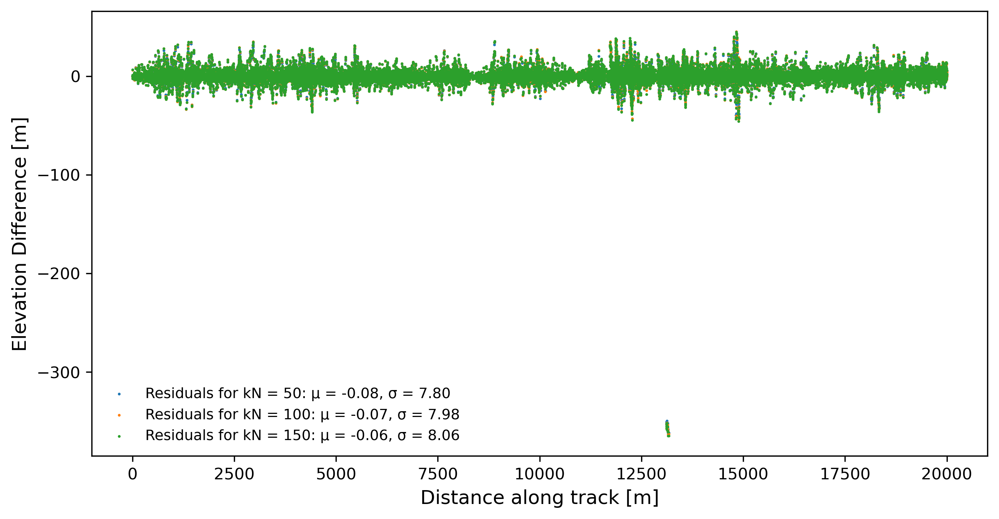

In [16]:
# plot 'residuals' (difference of photon elevation and corresponding polyfit elevation)
fig, ax = plt.subplots(1,1,figsize=(10,5))
fig.set_dpi(300)
for i, j in zip(range(3), np.arange(50,200,50)):
    diff = xy[:,1]-kN_pfit[i]
    ax.scatter(xy[:,0], diff, s=0.5, label=f'Residuals for kN = {j}: μ = {np.mean(diff):.2f}, σ = {np.std(diff):.2f}');
ax.set_ylabel('Elevation Difference [m]', fontsize=12)
ax.set_xlabel('Distance along track [m]', fontsize=12)
ax.legend(frameon=False, fontsize=9, loc='lower left');

<p style="text-align:center"> Fig. 5: Difference between photons and polynomial fit of different neighborhood sizes </p>

In [25]:
# as some residuals are very large due to outlier photons, set values in polyfit array with large residuals to nan 
kN_pfit_fil = np.array(kN_pfit, copy=True)
for i, j in zip(np.arange(0, len(kN_pfit)), kN_arr):
    diff = xy[:,1]-kN_pfit[i]
    kN_pfit_fil[i][np.abs(diff) > 50] = np.nan

# gaussian average smoothing
kN_pfit_smooth = []
for i in range(3):
    pfit_smooth_elev = gaussian_filter(kN_pfit_fil[i], sigma=5)
    kN_pfit_smooth.append(pfit_smooth_elev)

In [26]:
# print mean and standard deviation of all polynomial fits

# residuals of rough polyfit
print('Residuals rough fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy[:,1]-kN_pfit[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# remove outliers, residuals of rough polyfit
print('\nResiduals filtered rough fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy[:,1]-kN_pfit_fil[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit
print('\nResiduals smoothed fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy[:,1]-kN_pfit_smooth[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit against copernicus 30m DEM 
print('\nResiduals smoothed fit-GLO-30 DEM for')
for i, j in zip(range(3), kN_arr):
    diff = gdf_swath1.glo30_ell-kN_pfit_smooth[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')

Residuals rough fit-photons for 
kN = 50: Mean = -0.08, StDev = 7.80
kN = 100: Mean = -0.07, StDev = 7.98
kN = 150: Mean = -0.06, StDev = 8.06

Residuals filtered rough fit-photons for 
kN = 50: Mean = 0.05, StDev = 3.70
kN = 100: Mean = 0.06, StDev = 4.03
kN = 150: Mean = 0.07, StDev = 4.17

Residuals smoothed fit-photons for 
kN = 50: Mean = 0.05, StDev = 4.17
kN = 100: Mean = 0.06, StDev = 4.21
kN = 150: Mean = 0.07, StDev = 4.27

Residuals smoothed fit-GLO-30 DEM for
kN = 50: Mean = -1.34, StDev = 4.58
kN = 100: Mean = -1.33, StDev = 4.50
kN = 150: Mean = -1.32, StDev = 4.42


#### Finding the right degree of the polynomial fit function

In [27]:
# set neighborhood size to 150, now calculate polynomial fit for linear, quadratic and cubic fit (degree = 1, 2, 3)
degree_pfit = []

for i in np.arange(1,4):
    start_time = timer()
    _, pfit_elev_deg = polyfit_numpy(xy, 150, i)
    degree_pfit.append(pfit_elev_deg)
    end_timer = timer()
    print(f'Degree {i} done')
    print(f'Time elapsed: {end_timer-start_time:.1f} seconds')

degree_names = ['Linear', 'Quadratic', 'Cubic']

Degree 1 done
Time elapsed: 34.8 seconds
Degree 2 done
Time elapsed: 60.8 seconds
Degree 3 done
Time elapsed: 94.8 seconds


In [28]:
# filter by outliers and perform gaussian smoothing

degree_pfit_fil = degree_pfit

for i in range(3):
    diff = xy[:,1]-degree_pfit_fil[i]
    degree_pfit_fil[i][np.abs(diff) > 50] = np.nan

degree_pfit_smooth = []
for i in range(3):
    pfit_smooth_elev = gaussian_filter(degree_pfit_fil[i], sigma=5)
    degree_pfit_smooth.append(pfit_smooth_elev)

In [29]:
# residuals of rough polyfit
print('Residuals rough fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy[:,1]-degree_pfit[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# remove outliers, residuals of rough polyfit
print('\nResiduals filtered rough fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy[:,1]-degree_pfit_fil[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit
print('\nResiduals smoothed fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy[:,1]-degree_pfit_smooth[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit against copernicus 30m DEM 
print('\nResiduals smoothed fit-GLO-30 DEM for')
for i, j in zip(range(3), degree_names):
    diff = gdf_swath1.glo30_ell-degree_pfit_smooth[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')

Residuals rough fit-photons for 
Linear: Mean = 0.07, StDev = 4.17
Quadratic: Mean = 0.07, StDev = 4.18
Cubic: Mean = 0.06, StDev = 4.21

Residuals filtered rough fit-photons for 
Linear: Mean = 0.07, StDev = 4.17
Quadratic: Mean = 0.07, StDev = 4.18
Cubic: Mean = 0.06, StDev = 4.21

Residuals smoothed fit-photons for 
Linear: Mean = 0.07, StDev = 4.27
Quadratic: Mean = 0.07, StDev = 4.23
Cubic: Mean = 0.06, StDev = 4.23

Residuals smoothed fit-GLO-30 DEM for
Linear: Mean = -1.32, StDev = 4.42
Quadratic: Mean = -1.33, StDev = 4.57
Cubic: Mean = -1.34, StDev = 4.56


#### Outlier filtering

In [30]:
# filter xy by outliers, threshold of 2nd percentile
xy2, outlier_ind = outlier_filter_k(xy, 10, p=2)

In [31]:
# repeat neighborhood size and polynomial degree testing
kN_arr = np.array([50, 100, 150])
_, kN_pfit_o = polyfit_numpy(xy2, kN_arr, 1)

kN_pfit_fil_o = np.array(kN_pfit_o, copy=True)
for i in range(3):
    diff = xy2[:,1]-kN_pfit_o[i]
    kN_pfit_fil_o[i][np.abs(diff) > 50] = np.nan
    
kN_pfit_smooth_o = []
for i in range(3):
    pfit_smooth_elev = gaussian_filter(kN_pfit_fil_o[i], sigma=5)
    kN_pfit_smooth_o.append(pfit_smooth_elev)

 kN = 50: Time elapsed: 33.3 seconds
 kN = 100: Time elapsed: 33.6 seconds
 kN = 150: Time elapsed: 33.9 seconds


In [32]:
# residuals of rough polyfit
print('Residuals rough fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy2[:,1]-kN_pfit_o[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# remove outliers, residuals of rough polyfit
print('\nResiduals filtered rough fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy2[:,1]-kN_pfit_fil_o[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit
print('\nResiduals smoothed fit-photons for ')
for i, j in zip(range(3), kN_arr):
    diff = xy2[:,1]-kN_pfit_smooth_o[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit against copernicus 30m DEM 
print('\nResiduals smoothed fit-GLO-30 DEM for')
gdf_swath1_o = gdf_swath1.iloc[outlier_ind]
for i, j in zip(range(3), kN_arr):
    diff = gdf_swath1_o.glo30_ell-kN_pfit_smooth_o[i]
    print(f'kN = {j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')

Residuals rough fit-photons for 
kN = 50: Mean = -0.09, StDev = 6.65
kN = 100: Mean = -0.09, StDev = 6.79
kN = 150: Mean = -0.08, StDev = 6.86

Residuals filtered rough fit-photons for 
kN = 50: Mean = 0.01, StDev = 2.74
kN = 100: Mean = 0.02, StDev = 3.02
kN = 150: Mean = 0.03, StDev = 3.17

Residuals smoothed fit-photons for 
kN = 50: Mean = 0.01, StDev = 3.10
kN = 100: Mean = 0.02, StDev = 3.15
kN = 150: Mean = 0.03, StDev = 3.24

Residuals smoothed fit-GLO-30 DEM for
kN = 50: Mean = -1.36, StDev = 4.59
kN = 100: Mean = -1.36, StDev = 4.51
kN = 150: Mean = -1.35, StDev = 4.43


In [33]:
degree_pfit_o = []

for i in np.arange(1,4):
    start_time = timer()
    _, pfit_elev_deg = polyfit_numpy(xy2, 150, i)
    degree_pfit_o.append(pfit_elev_deg)
    end_timer = timer()
    print(f'Degree {i} done')
    print(f'Time elapsed: {end_timer-start_time:.1f} seconds')

degree_pfit_fil_o = degree_pfit_o
for i in range(3):
    diff = xy2[:,1]-degree_pfit_o[i]
    degree_pfit_fil_o[i][np.abs(diff) > 50] = np.nan
    
degree_pfit_smooth_o = []
for i in range(3):
    pfit_smooth_elev = gaussian_filter(degree_pfit_fil_o[i], sigma=5)
    degree_pfit_smooth_o.append(pfit_smooth_elev)

Degree 1 done
Time elapsed: 33.9 seconds
Degree 2 done
Time elapsed: 59.4 seconds
Degree 3 done
Time elapsed: 92.2 seconds


In [34]:
# residuals of rough polyfit
print('Residuals rough fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy2[:,1]-degree_pfit_o[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# remove outliers, residuals of rough polyfit
print('\nResiduals filtered rough fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy2[:,1]-degree_pfit_fil_o[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit
print('\nResiduals smoothed fit-photons for ')
for i, j in zip(range(3), degree_names):
    diff = xy2[:,1]-degree_pfit_smooth_o[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')
    
# residuals of smoothed fit against copernicus 30m DEM 
print('\nResiduals smoothed fit-GLO-30 DEM for')
for i, j in zip(range(3), degree_names):
    diff = gdf_swath1_o.glo30_ell-degree_pfit_smooth_o[i]
    print(f'{j}: Mean = {np.nanmean(diff):.2f}, StDev = {np.nanstd(diff):.2f}')

Residuals rough fit-photons for 
Linear: Mean = 0.03, StDev = 3.17
Quadratic: Mean = 0.02, StDev = 3.12
Cubic: Mean = 0.01, StDev = 3.14

Residuals filtered rough fit-photons for 
Linear: Mean = 0.03, StDev = 3.17
Quadratic: Mean = 0.02, StDev = 3.12
Cubic: Mean = 0.01, StDev = 3.14

Residuals smoothed fit-photons for 
Linear: Mean = 0.03, StDev = 3.24
Quadratic: Mean = 0.02, StDev = 3.15
Cubic: Mean = 0.01, StDev = 3.15

Residuals smoothed fit-GLO-30 DEM for
Linear: Mean = -1.35, StDev = 4.43
Quadratic: Mean = -1.35, StDev = 4.58
Cubic: Mean = -1.36, StDev = 4.57


#### Extracting ground profile photons

In [7]:
# set up full length swath and duplicate it for iterating over
xy = ATL_conf[['alongtrack_base', 'Photon_Height']].to_numpy()
xy_loop = np.array(xy, copy=True)

# loop 4 times: bin swath in 30 m segments, remove residuals of lower and upper 20th percentile, concatenate swath segments and repeat
# in the end, only the points with the least difference to photons should be left --> ground profile photons
# assumes residuals are normal distributed
for i in range(4):
    print(f'Loop {i+1}')
    print(f'Number of photons: {len(xy_loop)}')
    # calculate linear fit on kN = 150, smooth, remove outliers
    coeffs, pfit_elev = polyfit_numpy(xy_loop, 150, 1)
    pfit_elev_smooth = gaussian_filter(pfit_elev, sigma=5)
    pfit_elev_smooth[np.abs(xy_loop[:,1]-pfit_elev_smooth) > 50] = np.nan
    print(f'Number of elements in smoothed polyfit: {np.sum(~np.isnan(pfit_elev_smooth))}')

    # suppress 'All-NaN slice encountered' or 'Mean of empty slice' RuntimeWarnings that will occur
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=RuntimeWarning)
        # statistics on photon residuals
        residuals = xy_loop[:,1] - pfit_elev_smooth
        print(f'Max residual at index {np.nanargmax(residuals)} with {np.nanmax(residuals):.2f} m')
        print(f'Min residual at index {np.nanargmin(residuals)} with {np.nanmin(residuals):.2f} m')
        print(f'StDev of residuals: {np.nanstd(residuals):.2f}')

        # split photons and residuals into 30 m bins
        split_at = xy_loop[:, 0].searchsorted(np.arange(0, int(max(xy_loop[:,0])), 30))
        xy_bins = np.split(xy_loop, split_at)
        residuals_bins = np.split(residuals, split_at)

        # empty list to catch filtered photon bins
        new_xy_bins = []
        for j in range(len(xy_bins)):
            # retrieve indices where residuals are in 20-80th residual percentile
            filtered_ind, = np.where((residuals_bins[j] > np.nanpercentile(residuals_bins[j], 20)) & 
                                     (residuals_bins[j] < np.nanpercentile(residuals_bins[j], 80)))
            # save photons at valid indices
            new_xy_bins.append(xy_bins[j][filtered_ind])
        # regroup bins back to full array
        xy_loop = np.concatenate(new_xy_bins)
        np.save(f'xy_loop_{i}.npy', xy_loop)
    
    print(f'No of ground photon candidates: {xy_loop.shape[0]}\n')

Loop 1
Number of photons: 184825
Number of elements in smoothed polyfit: 184610
Max residual at index 130256 with 49.82 m
Min residual at index 175778 with -49.88 m
StDev of residuals: 5.50
No of ground photon candidates: 109166

Loop 2
Number of photons: 109166
Number of elements in smoothed polyfit: 109148
Max residual at index 106539 with 49.81 m
Min residual at index 78397 with -32.68 m
StDev of residuals: 2.77
No of ground photon candidates: 63880

Loop 3
Number of photons: 63880
Number of elements in smoothed polyfit: 63865
Max residual at index 62341 with 42.74 m
Min residual at index 55393 with -49.81 m
StDev of residuals: 4.44
No of ground photon candidates: 36693

Loop 4
Number of photons: 36693
Number of elements in smoothed polyfit: 36641
Max residual at index 17069 with 43.00 m
Min residual at index 29468 with -49.57 m
StDev of residuals: 7.62
No of ground photon candidates: 20440



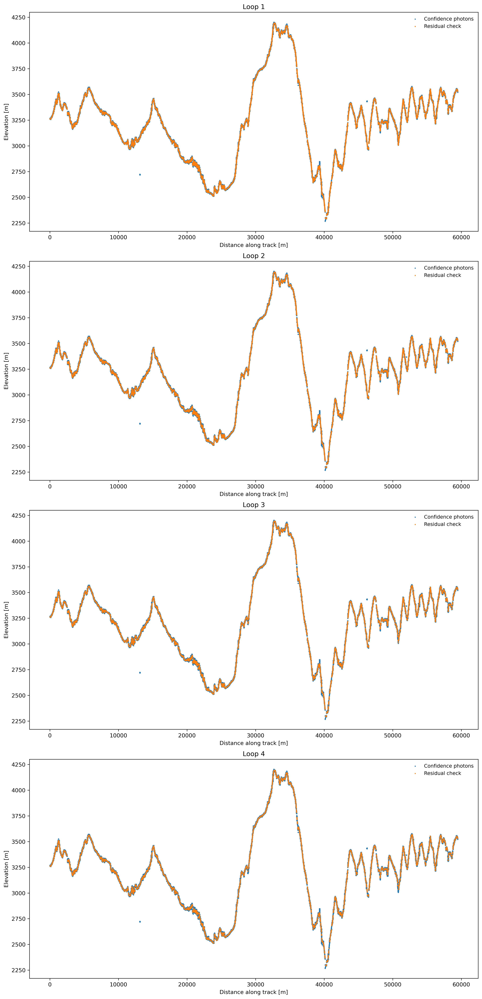

In [9]:
# plot xy_loop photons for every loop

fig, ax = plt.subplots(4,1, figsize=(12,25), constrained_layout=True)
ax = ax.ravel()
fig.set_dpi(300)
for i in range(4):
    ax[i].scatter(xy[:,0], xy[:,1], s=1, label='Confidence photons')
    xy_loop = np.load(f'../data/variables/xy_loop_{i}.npy')
    ax[i].scatter(xy_loop[:,0], xy_loop[:,1], s=0.8, label='Residual check')
    ax[i].legend(frameon=False, fontsize=9)
    ax[i].set_ylabel('Elevation [m]')
    ax[i].set_xlabel('Distance along track [m]')
    ax[i].set_title(f'Loop {i+1}');

<p style="text-align:center"> Fig. 6: Iterative removal of outlier photons for ground profile retrieval </p>

#### Ground photons of all swaths

In [8]:
# iterate through each item (=swath) in ATL03_list 
for i in range(len(ATL03_list)):
    start = timer()
    print(f'Processing: {tracknames[i]}')
    # filter ATL03 dataframe by confidence (higher than or equal to 'low')
    swath_conf = ATL03_list[i][ATL03_list[i]['Land'] >= 2]
    # write alongtrack_base and photon height to numpy array
    xy = swath_conf[['alongtrack_base', 'Photon_Height']].to_numpy()
    
    # first round of polynomial fitting, gaussian average smoothing and residual outlier filtering
    print('First polyfit filtering')
    _, pfit_elev = polyfit_numpy(xy, 150, 1)
    pfit_elev_smooth = gaussian_filter(pfit_elev, sigma=5)
    pfit_elev_smooth[np.abs(xy[:,1]-pfit_elev_smooth) > 50] = np.nan
    print(f'Number of elements in smoothed polyfit: {np.sum(~np.isnan(pfit_elev_smooth))}')
    
    # statistics on photon residuals
    residuals = xy[:,1] - pfit_elev_smooth
    # suppress 'All-NaN slice encountered' or 'Mean of empty slice' RuntimeWarnings that will occur
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=RuntimeWarning)
        print(f'Max residual at index {np.nanargmax(residuals)} with {np.nanmax(residuals):.2f} m')
        print(f'Min residual at index {np.nanargmin(residuals)} with {np.nanmin(residuals):.2f} m')
        print(f'StDev of residuals: {np.nanstd(residuals):.2f}')
    
        # split photons and residuals into 30 m bins
        split_at = xy[:, 0].searchsorted(np.arange(0, int(max(xy[:,0])), 30))
        # first bin is empty as it is split at 0 m, second one from 0.6 m to 29 m,  etc
        xy_bins = np.split(xy, split_at)
        residuals_bins = np.split(residuals, split_at)
        
        # empty lists to catch filtered photon bins and the indices of remaining points
        new_xy_bins = []
        filtered_ind = []
        # iterate through all photon and residuals bins, excluding the empty first one
        for k in np.arange(1, len(xy_bins)):
            # retrieve indices where residuals are in 20-80th residual percentile
            indi, = np.where((residuals_bins[k] > np.nanpercentile(residuals_bins[k], 20)) & 
                                     (residuals_bins[k] < np.nanpercentile(residuals_bins[k], 80)))
            # save photons at valid indices
            new_xy_bins.append(xy_bins[k][indi])
            # save valid indices (since indices are from bins, add the split location value to them)
            filtered_ind.append(indi+split_at[k-1])
        # regroup bins back to full array
        xy_ground = np.concatenate(new_xy_bins)
        filtered_ind = np.concatenate(filtered_ind)
        print(f'No of ground photon candidates: {xy_ground.shape[0]}\n')
    
        print('Second polyfit filtering')
        # perform polynomial fitting and smoothing again on the residual filtered swath
        coeffs, pfit_elev_ground = polyfit_numpy(xy_ground, 150, 1)
        pfit_elev_smooth_ground = gaussian_filter(pfit_elev_ground, sigma=5)
        pfit_elev_smooth_ground[np.abs(xy_ground[:,1]-pfit_elev_smooth_ground) > 50] = np.nan

        residuals = xy_ground[:,1] - pfit_elev_smooth_ground
        print(f'Max residual at index {np.nanargmax(residuals)} with {np.nanmax(residuals):.2f} m')
        print(f'Min residual at index {np.nanargmin(residuals)} with {np.nanmin(residuals):.2f} m')
        print(f'StDev of residuals: {np.nanstd(residuals):.2f}')
    
    # create new dataframe at valid indices
    ATL_sub = swath_conf.iloc[filtered_ind]
    # create geodataframe from ATL_sub, derive geometry from photon lat/lon
    gdf = gp.GeoDataFrame(ATL_sub, geometry=gp.points_from_xy(ATL_sub.Longitude, ATL_sub.Latitude), crs=4326)
    # write geometry coordinates to list
    coord_list = [(x,y) for x,y in zip(gdf['geometry'].x , gdf['geometry'].y)]
    
    # sample the DEM value for the location of each photon (coord_list) and convert to float
    gdf['geoid_undul'] = [x for x in src_geoid.sample(coord_list)]
    gdf['geoid_float'] = gdf.geoid_undul.astype(float)
    
    gdf['glo30_height'] = [x for x in src_glo30.sample(coord_list)]
    gdf['glo30_float'] = gdf.glo30_height.astype(float)
    # fix difference between vertical crs
    gdf['glo30_ell'] = np.add(gdf.glo30_float, gdf.geoid_float)
    
    gdf['qdt3_height'] = [x for x in src_qdt3.sample(coord_list)]
    gdf['qdt3_float'] = gdf.qdt3_height.astype(float)
    # nodata value is converted to nan to not influence results
    gdf = gdf.replace(src_qdt3.nodata, np.nan)
    
    gdf['salta5_height'] = [x for x in src_salta5.sample(coord_list)]
    gdf['salta5_float'] = gdf.salta5_height.astype(float)
    gdf = gdf.replace(src_salta5.nodata, np.nan)
    gdf['salta5_float'] = np.add(gdf.salta5_float, gdf.geoid_float)
    
    # add polyfits to gdf
    gdf['pfit_slope'] = coeffs[:,0].tolist()
    gdf['pfit_elev'] = pfit_elev_ground.tolist()
    gdf['pfit_smoothed_elev'] = pfit_elev_smooth_ground.tolist()
    
    # salta DEM has some areas where difference to GLO-30 is very large (up to 250 meters) --> set those values to nan
    gdf.salta5_float[(gdf.glo30_ell - gdf.salta5_float) > 30] = np.nan
    
    # new dataframe where initial sample columns are dropped (float columns remain)
    gdf2 = gdf.drop(['geoid_undul', 'glo30_height', 'glo30_float', 'qdt3_height', 'salta5_height'], axis=1)
    
    # if swath directory does not exist, create it
    swath_path = '../data/swaths/'
    if not os.path.exists(swath_path):
        os.mkdir(swath_path)
        
    # write geodataframe with polynomial fit elevation to shapefile 
    # (and suppress 'Column names longer than 10 characters will be truncated when saved to ESRI Shapefile' warning)
    with warnings.catch_warnings():
        warnings.simplefilter('ignore', category=UserWarning)
        gdf2.to_file(f'../data/swaths/swath{i}.shp')
    
    end = timer()
    
    print(f'{tracknames[i]} done in {(end-start):.1f}s\n\n')

Processing: GT1L
First polyfit filtering
Number of elements in smoothed polyfit: 184610
Max residual at index 130256 with 49.82 m
Min residual at index 175778 with -49.88 m
StDev of residuals: 5.50
No of ground photon candidates: 109166

Second polyfit filtering
Max residual at index 106539 with 49.81 m
Min residual at index 78397 with -32.68 m
StDev of residuals: 2.77
GT1L done in 183.4s


Processing: GT1R
First polyfit filtering
Number of elements in smoothed polyfit: 48982
Max residual at index 27042 with 49.98 m
Min residual at index 41494 with -49.97 m
StDev of residuals: 12.48
No of ground photon candidates: 28089

Second polyfit filtering
Max residual at index 3144 with 49.73 m
Min residual at index 20965 with -49.92 m
StDev of residuals: 9.55
GT1R done in 49.8s


Processing: GT2L
First polyfit filtering
Number of elements in smoothed polyfit: 120963
Max residual at index 52050 with 49.96 m
Min residual at index 67409 with -49.94 m
StDev of residuals: 5.57
No of ground photon ca

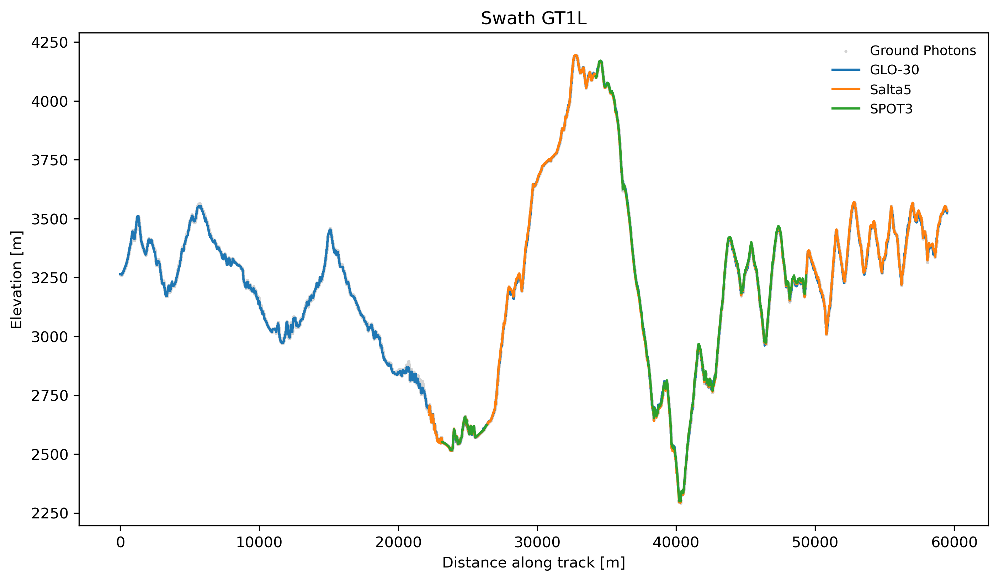

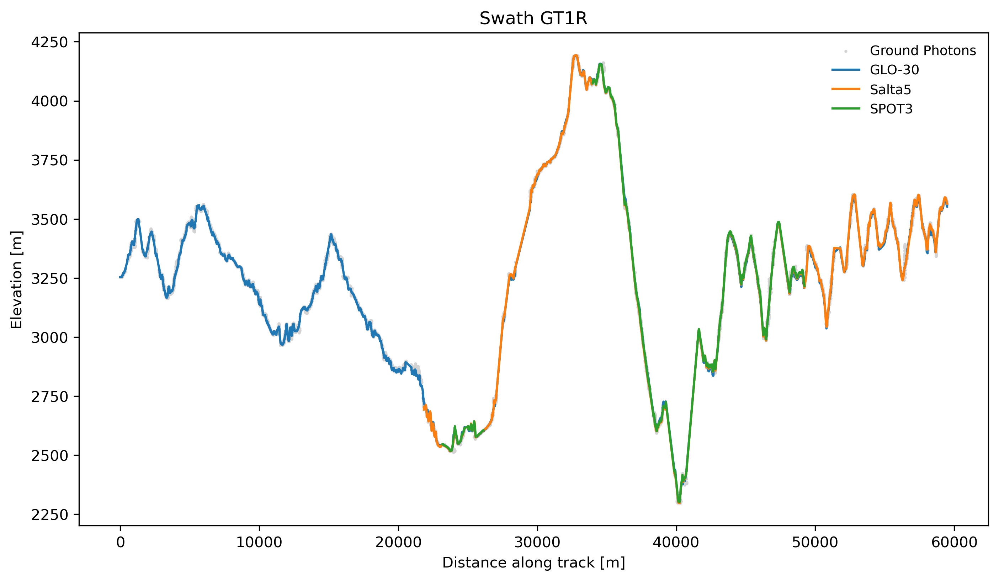

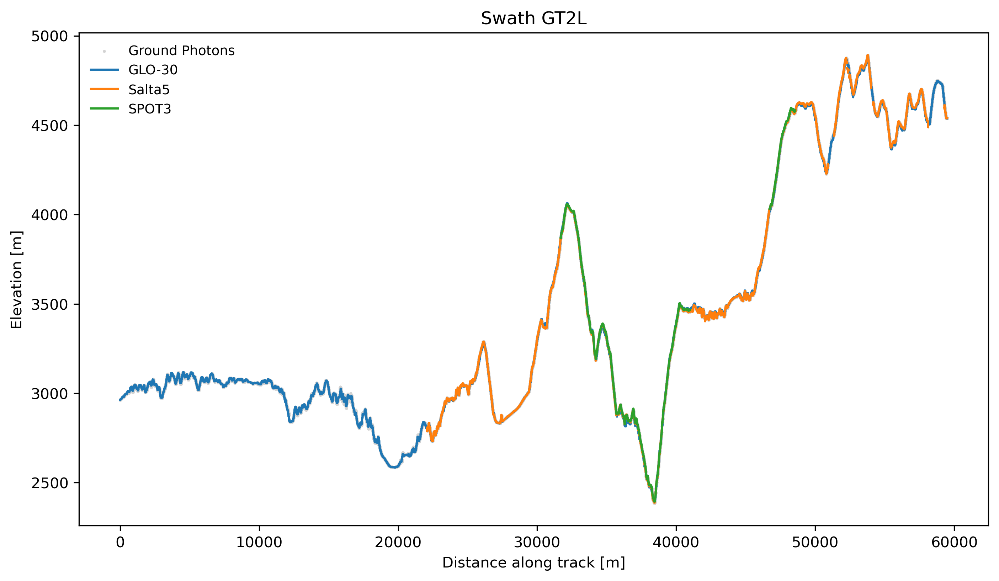

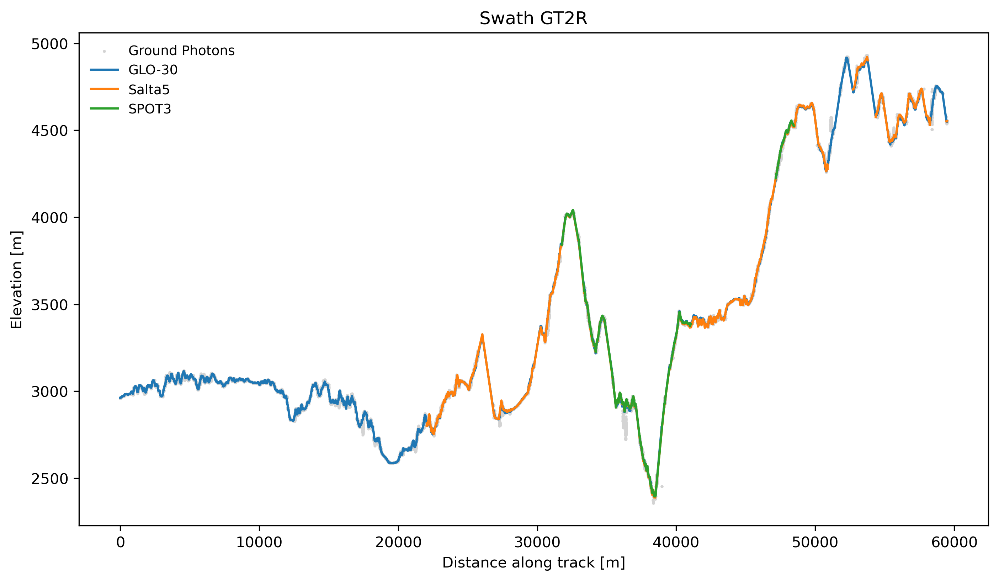

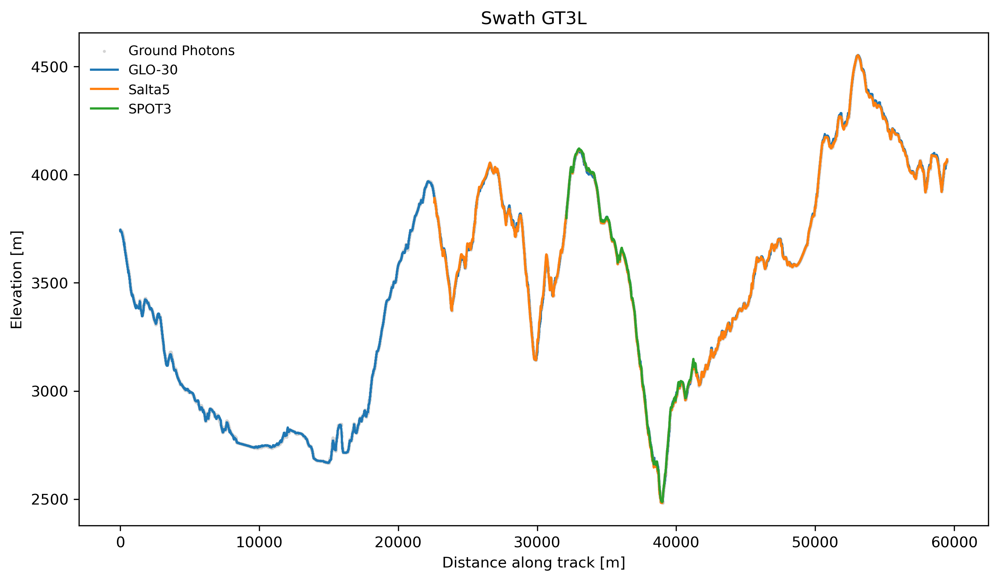

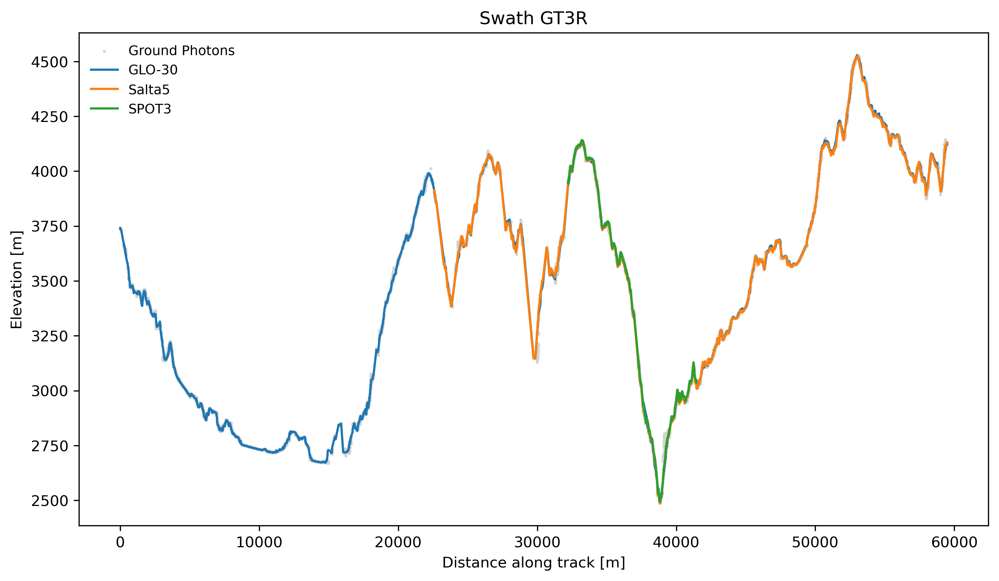

In [9]:
# plot ground photons and DEM elevations along the track 
for i in range(6):
    gdf = gp.read_file(f'../data/swaths/swath{i}.shp')
    fig, ax = plt.subplots(1,1,figsize=(11,6))
    fig.set_dpi(300)
    ax.scatter(gdf.alongtra_1, gdf.Photon_Hei, s=1, color='lightgrey', label='Ground Photons')
    ax.plot(gdf.alongtra_1, gdf.glo30_ell, label='GLO-30')
    ax.plot(gdf.alongtra_1, gdf.salta5_flo, label='Salta5')
    ax.plot(gdf.alongtra_1, gdf.qdt3_float, label='SPOT3')
    ax.set_title(f'Swath {tracknames[i]}')
    ax.legend(frameon=False, fontsize=9)
    ax.set_ylabel('Elevation [m]')
    ax.set_xlabel('Distance along track [m]')
    plt.savefig(f'../figures/DEM_Swath{i}.png', bbox_inches='tight')

<p style="text-align:center"> Fig. 7: Ground Photons and DEM Values of Swaths </p>

In [10]:
# interactive plot

import plotly.express as px
import plotly.graph_objects as go
fig1 = px.scatter_mapbox(gp.read_file('../data/swaths/swath0.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)
fig2 = px.scatter_mapbox(gp.read_file('../data/swaths/swath1.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)

fig3 = px.scatter_mapbox(gp.read_file('../data/swaths/swath2.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)
fig4 = px.scatter_mapbox(gp.read_file('../data/swaths/swath3.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)

fig5 = px.scatter_mapbox(gp.read_file('../data/swaths/swath4.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)
fig6 = px.scatter_mapbox(gp.read_file('../data/swaths/swath5.shp'), 
                        lat='Latitude', 
                        lon='Longitude',
                        color='Photon_Hei', zoom=9)

fig_t = go.Figure(data=fig1.data + fig2.data + fig3.data + fig4.data + fig5.data + fig6.data)
fig_t.update_layout(mapbox_style="stamen-terrain")

fig_t.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig_t.show();

c:\Users\Franzi\miniconda3\envs\icesat2\lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



<p style="text-align:center"> Fig. 8: Elevation of ground photons in interactive map</p>

#### Residuals with DEMs

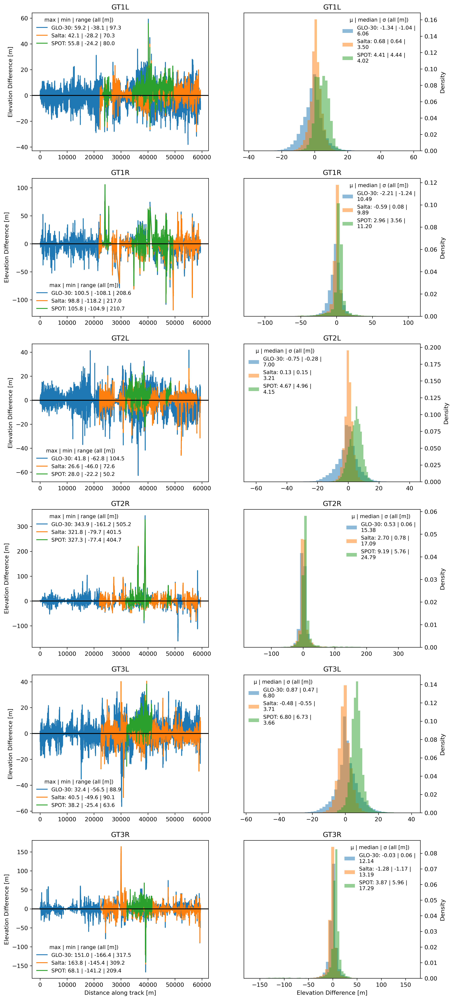

In [11]:
fig, ax = plt.subplots(6,2,figsize=(12,30))
ax = ax.ravel()
fig.set_dpi(300)

for i, j, k in zip(range(6), np.arange(0,12,2), np.arange(1,13,2)):
    gdf = gp.read_file(f'../data/swaths/swath{i}.shp')
    diff = gdf.glo30_ell - gdf.Photon_Hei
    ax[j].plot(gdf.alongtra_1, diff, label=f'GLO-30: {np.nanmax(diff):.1f} | {np.nanmin(diff):.1f} | {np.nanmax(diff)-np.nanmin(diff):.1f}')
    ax[k].hist(diff, bins=50, density=True, alpha=0.5, label=f'GLO-30: {np.nanmean(diff):.2f} | {np.nanmedian(diff):.2f} |\n{np.nanstd(diff):.2f}')
    
    diff = gdf.salta5_flo - gdf.Photon_Hei
    ax[j].plot(gdf.alongtra_1, diff, label=f'Salta: {np.nanmax(diff):.1f} | {np.nanmin(diff):.1f} | {np.nanmax(diff)-np.nanmin(diff):.1f}')
    ax[k].hist(diff, bins=50,  density=True, alpha=0.5, label=f'Salta: {np.nanmean(diff):.2f} | {np.nanmedian(diff):.2f} |\n{np.nanstd(diff):.2f}')
    
    diff = gdf.qdt3_float - gdf.Photon_Hei
    ax[j].plot(gdf.alongtra_1, diff, label=f'SPOT: {np.nanmax(diff):.1f} | {np.nanmin(diff):.1f} | {np.nanmax(diff)-np.nanmin(diff):.1f}')
    ax[k].hist(diff, bins=50,  density=True, alpha=0.5, label=f'SPOT: {np.nanmean(diff):.2f} | {np.nanmedian(diff):.2f} |\n{np.nanstd(diff):.2f}')
    
    ax[j].axhline(0, c='k')
    
    ax[j].legend(frameon=False, fontsize=9, title='max | min | range (all [m])', title_fontsize=9);
    ax[k].legend(frameon=False, fontsize=9, title='μ | median | σ (all [m])', title_fontsize=9);
    
    ax[j].set_title(f'{tracknames[i]}');
    ax[k].set_title(f'{tracknames[i]}');
    
    ax[k].yaxis.tick_right()
    ax[k].yaxis.set_label_position("right")
    ax[j].set_ylabel('Elevation Difference [m]')
    ax[k].set_ylabel('Density');
    
ax[j].set_xlabel('Distance along track [m]')
ax[k].set_xlabel('Elevation Difference [m]');

plt.savefig('../figures/residuals_dems.png', bbox_inches='tight')

<p style="text-align:center"> Fig. 9: Residuals of Ground Photons and DEMs, left side: distribution along the track, right side: histograms </p>

#### Ground profile approximation and final comparison with ATL08

In [4]:
# ATL08

# import ATL08 product of same swath for comparison
ATL08_input_path = '../data/ICESAT_Tracks/ATL08/raw_h5/ATL08_20220529163730_10321508_005_02.h5'
ATL08_output_path = '../data/ICESAT_Tracks/ATL08/hdf/'

# extract ATL08 with modified function from paper by Atmani, Bodo Bookhagen, and Smith, 2022
ATL08_files = list(glob.glob(ATL08_input_path))
ATL08_files.sort()
for fname in ATL08_files:  
    ATL08_minimal(fname, ATL08_output_path, ROI_fname, EPSG_Toro, reprocess=False)

# load in extracted hdf files of all 6 ground tracks
ATL08_land_files = glob.glob(os.path.join(ATL08_output_path, 'ATL08_Land_*.hdf'))
ATL08_land_files.sort()

# set up a dataframe list and fill with dataframes of each individual ground track (6 total)
ATL08_list = []
for i in range(len(ATL08_land_files)):
    ATL08_df = pd.read_hdf(ATL08_land_files[i], mode='r')
    ATL08_df = ATL08_df.sort_values(by=['alongtrack'], ascending=True).reset_index()
    ATL08_list.append(ATL08_df)

Opening ATL08_20220529163730_10321508_005_02.h5: gt1l
File with gt1l already exists and reprocessing is turned off.

Opening ATL08_20220529163730_10321508_005_02.h5: gt1r
File with gt1r already exists and reprocessing is turned off.

Opening ATL08_20220529163730_10321508_005_02.h5: gt2l
File with gt2l already exists and reprocessing is turned off.

Opening ATL08_20220529163730_10321508_005_02.h5: gt2r
File with gt2r already exists and reprocessing is turned off.

Opening ATL08_20220529163730_10321508_005_02.h5: gt3l
File with gt3l already exists and reprocessing is turned off.

Opening ATL08_20220529163730_10321508_005_02.h5: gt3r
File with gt3r already exists and reprocessing is turned off.



In [13]:
# compare strong beam ground approximation

# beam
q = 0

# open shapefile with ground photons
gdf = gp.read_file(f'../data/swaths/swath{q}.shp')

# ATL03
xy = gdf[['alongtrack', 'Photon_Hei']].to_numpy()

# ground profile from polynomial fit
pfit_smooth = gdf.pfit_smoot

# ATL08
ATL08 = ATL08_list[q][['alongtrack', 'best_fit_Height']].to_numpy()

# DEMs
# Copernicus 30m
glo30 = gdf.glo30_ell

# SPOT 3m
qdt3 = gdf.qdt3_float

# Salta 5m
salta5 = gdf.salta5_flo

# lowess
xy_lowess = lowess(xy[:,1], xy[:,0], frac=1./(len(xy)/100))

# kalman filter
observations = xy[:,1]
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=DeprecationWarning)
    kf = KalmanFilter(initial_state_mean = np.array([xy[0,1],0]))
    kf_pred, _ = kf.smooth(observations)
kf_smooth = gaussian_filter(kf_pred[:,0], sigma=5)

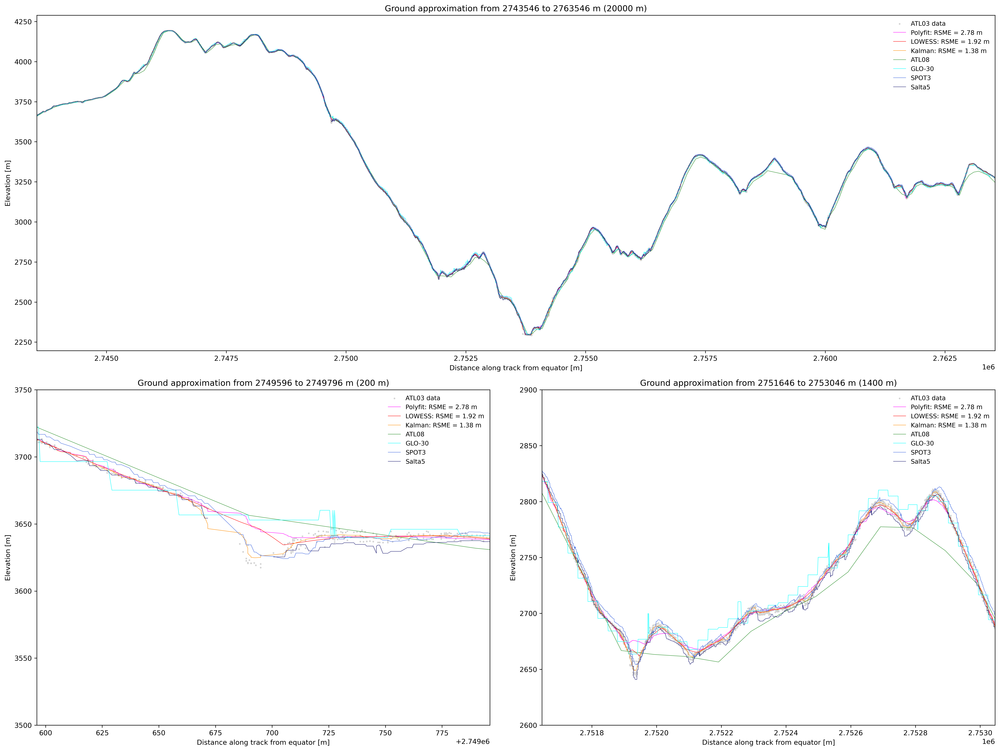

In [14]:
# plot all ground approximations together over three subsets
fig = plt.figure(figsize=(20,15), constrained_layout=True)
fig.set_dpi(300)
gs = fig.add_gridspec(2, 2)

s = gdf[gdf['Land'] >= 2]['alongtrack'][0]
subsets = [(30000,50000), (36050,36250), (38100,39500)]
ax0 = fig.add_subplot(gs[0, :])
ax1 = fig.add_subplot(gs[-1, 0])
ax1.set_ylim((3500,3750))
ax2 = fig.add_subplot(gs[-1, -1])
ax2.set_ylim((2600,2900))

axes = [ax0, ax1, ax2]

for i in range(3):
    axes[i].scatter(xy[:-1,0], xy[:-1,1], s=2, c='lightgrey', label='ATL03 data')
    axes[i].plot(xy[:,0], pfit_smooth, lw=0.5, c='fuchsia', label=f'Polyfit: RSME = {np.sqrt(np.sum((xy[:,1]-pfit_smooth)**2)/len(xy)):.2f} m')
    axes[i].plot(xy[:,0], xy_lowess[:,1], lw=0.5, color='r', label=f'LOWESS: RSME = {np.sqrt(np.sum((xy[:,1]-xy_lowess[:,1])**2)/len(xy)):.2f} m')
    axes[i].plot(xy[:,0], kf_smooth, lw=0.5, color='darkorange', label=f'Kalman: RSME = {np.sqrt(np.sum((xy[:,1]-kf_smooth)**2)/len(xy)):.2f} m')
    axes[i].plot(ATL08[:-1,0], ATL08[:-1,1], lw=0.5, c='forestgreen', label='ATL08')
    axes[i].plot(xy[:,0], glo30, lw=0.5, c='cyan', label='GLO-30')
    axes[i].plot(xy[:,0], qdt3, lw=0.5, c='royalblue', label='SPOT3')
    axes[i].plot(xy[:,0], salta5, lw=0.5, c='midnightblue', label='Salta5')
    axes[i].set_xlim((s+subsets[i][0],s+subsets[i][1]))
    axes[i].set_title(f'Ground approximation from {s+subsets[i][0]:.0f} to {s+subsets[i][1]:.0f} m ({subsets[i][1]-subsets[i][0]:.0f} m)')
    axes[i].set_xlabel('Distance along track from equator [m]')
    axes[i].set_ylabel('Elevation [m]')
    axes[i].legend(frameon=False, fontsize=9);
plt.savefig('../figures/profiles_gt1l.png', bbox_inches='tight')

<p style="text-align:center"> Fig. 11: Ground approximation on GT1L with different approaches: polynomial fitting, locally weighted scatterplot smoothing (LOWESS), Kalman filtering, DRAGANN algorithm used in ATL08 data and DEMs </p>

In [16]:
# compare weak beam ground approximation

# beam
q = 1

# open shapefile with ground photons
gdf = gp.read_file(f'../data/swaths/swath{q}.shp')

# ATL03
xy = gdf[['alongtrack', 'Photon_Hei']].to_numpy()

# ground profile from polynomial fit
pfit_smooth = gdf.pfit_smoot

# ATL08
ATL08 = ATL08_list[q][['alongtrack', 'best_fit_Height']].to_numpy()
# fix offset in data
ATL08[:,0] = ATL08[:,0] + (gdf.alongtrack[0] - ATL08[0,0]) 

# DEMs
# Copernicus 30m
glo30 = gdf.glo30_ell

# SPOT 3m
qdt3 = gdf.qdt3_float

# Salta 5m
salta5 = gdf.salta5_flo

# lowess
xy_lowess = lowess(xy[:,1], xy[:,0], frac=1./(len(xy)/100))

# kalman
observations = xy[:,1]
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=DeprecationWarning)
    kf = KalmanFilter(initial_state_mean = np.array([xy[0,1],0]))
    kf_pred, _ = kf.smooth(observations)
kf_smooth = gaussian_filter(kf_pred[:,0], sigma=5)

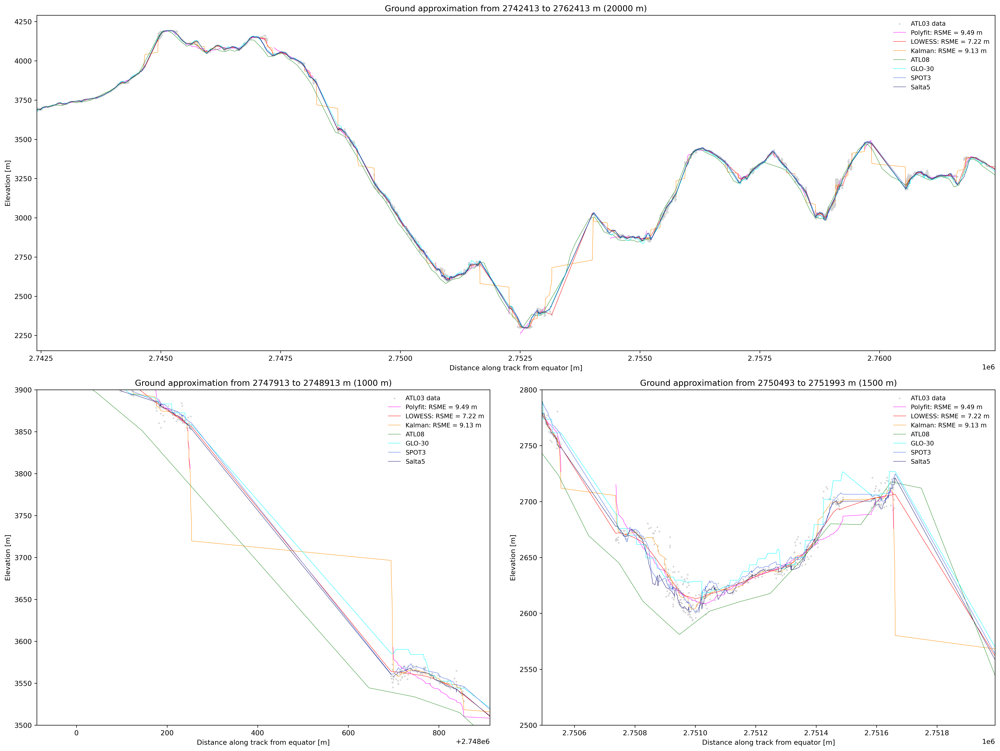

In [17]:
fig = plt.figure(figsize=(20,15), constrained_layout=True)
fig.set_dpi(300)
gs = fig.add_gridspec(2, 2)

s = gdf[gdf['Land'] >= 2]['alongtrack'][0]
subsets = [(30000,50000), (35500,36500), (38080,39580)]
ax0 = fig.add_subplot(gs[0, :])
ax1 = fig.add_subplot(gs[-1, 0])
ax1.set_ylim((3500,3900))
ax2 = fig.add_subplot(gs[-1, -1])
ax2.set_ylim((2500,2800))

axes = [ax0, ax1, ax2]

for i in range(3):
    axes[i].scatter(xy[:-1,0], xy[:-1,1], s=2, c='lightgrey', label='ATL03 data')
    axes[i].plot(xy[:,0], pfit_smooth, lw=0.5, c='fuchsia', label=f'Polyfit: RSME = {np.sqrt(np.sum((xy[:,1]-pfit_smooth)**2)/len(xy)):.2f} m')
    axes[i].plot(xy[:,0], xy_lowess[:,1], lw=0.5, color='r', label=f'LOWESS: RSME = {np.sqrt(np.sum((xy[:,1]-xy_lowess[:,1])**2)/len(xy)):.2f} m')
    axes[i].plot(xy[:,0], kf_smooth, lw=0.5, color='darkorange', label=f'Kalman: RSME = {np.sqrt(np.sum((xy[:,1]-kf_smooth)**2)/len(xy)):.2f} m')
    axes[i].plot(ATL08[:-1,0], ATL08[:-1,1], lw=0.5, c='forestgreen', label='ATL08')
    axes[i].plot(xy[:,0], glo30, lw=0.5, c='cyan', label='GLO-30')
    axes[i].plot(xy[:,0], qdt3, lw=0.5, c='royalblue', label='SPOT3')
    axes[i].plot(xy[:,0], salta5, lw=0.5, c='midnightblue', label='Salta5')
    axes[i].set_xlim((s+subsets[i][0],s+subsets[i][1]))
    axes[i].set_title(f'Ground approximation from {s+subsets[i][0]:.0f} to {s+subsets[i][1]:.0f} m ({subsets[i][1]-subsets[i][0]:.0f} m)')
    axes[i].set_xlabel('Distance along track from equator [m]')
    axes[i].set_ylabel('Elevation [m]')
    axes[i].legend(frameon=False, fontsize=9);
plt.savefig('../figures/profiles_gt1r.png', bbox_inches='tight')

<p style="text-align:center"> Fig. 12: Ground approximation on GT1R with different approaches: polynomial fitting, locally weighted scatterplot smoothing (LOWESS), Kalman filtering, DRAGANN algorithm used in ATL08 data and DEMs </p>

In [10]:
# print RMSE for all beams and polyfit/LOWESS/Kalman

for i in range(len(ATL03_list)):
    gdf = gp.read_file(f'../data/swaths/swath{i}.shp')
    xy = gdf[['alongtrack', 'Photon_Hei']].to_numpy()
    pfit_smooth = gdf.pfit_smoot
    xy_lowess = lowess(xy[:,1], xy[:,0], frac=1./(len(xy)/100))
    observations = xy[:,1]
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=DeprecationWarning)
        kf = KalmanFilter(initial_state_mean = np.array([xy[0,1],0]))
        kf_pred, _ = kf.smooth(observations)
    kf_smooth = gaussian_filter(kf_pred[:,0], sigma=5)
    
    print(f'{tracknames[i]}')
    print(f'Polyfit: RSME = {np.sqrt(np.sum((xy[:,1]-pfit_smooth)**2)/len(xy)):.2f} m')
    print(f'LOWESS: RSME = {np.sqrt(np.sum((xy[:,1]-xy_lowess[:,1])**2)/len(xy)):.2f} m')
    print(f'Kalman: RSME = {np.sqrt(np.sum((xy[:,1]-kf_smooth)**2)/len(xy)):.2f} m\n')

GT1L
Polyfit: RSME = 2.78 m
LOWESS: RSME = 1.92 m
Kalman: RSME = 1.38 m

GT1R
Polyfit: RSME = 9.49 m
LOWESS: RSME = 7.22 m
Kalman: RSME = 9.13 m

GT2L
Polyfit: RSME = 4.03 m
LOWESS: RSME = 2.50 m
Kalman: RSME = 1.55 m

GT2R
Polyfit: RSME = 10.64 m
LOWESS: RSME = 9.81 m
Kalman: RSME = 9.81 m

GT3L
Polyfit: RSME = 2.99 m
LOWESS: RSME = 1.98 m
Kalman: RSME = 1.33 m

GT3R
Polyfit: RSME = 9.48 m
LOWESS: RSME = 7.30 m
Kalman: RSME = 7.41 m

